In [2]:
from Analyzer import Analyzer
import numpy as np
import uproot as uproot

datapath = '/exp/dune/data/users/mking/'
inputwaveformlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/'
inputfilename = 'Waveforms_Noise_Data.root'
outputfftlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/'
outputfilename = 'AverageFFT_No_Cosmics.npz'

Waveform_File_Path = datapath + inputwaveformlocation + inputfilename

infile = uproot.open(Waveform_File_Path)
print(infile.keys())
print(np.shape(infile.keys()))

['run_13154_sub_1_event_1_daq;1', 'run_13154_sub_1_event_2_daq;1', 'run_13154_sub_1_event_3_daq;1', 'run_13154_sub_1_event_4_daq;1', 'run_13154_sub_1_event_5_daq;1', 'run_13154_sub_1_event_6_daq;1', 'run_13154_sub_1_event_7_daq;1', 'run_13154_sub_1_event_8_daq;1', 'run_13154_sub_1_event_9_daq;1', 'run_13154_sub_1_event_10_daq;1', 'run_13154_sub_1_event_11_daq;1', 'run_13154_sub_1_event_12_daq;1', 'run_13154_sub_1_event_13_daq;1', 'run_13154_sub_1_event_14_daq;1', 'run_13154_sub_1_event_15_daq;1', 'run_13154_sub_1_event_16_daq;1', 'run_13154_sub_1_event_17_daq;1', 'run_13154_sub_1_event_18_daq;1', 'run_13154_sub_1_event_19_daq;1', 'run_13154_sub_1_event_20_daq;1', 'run_13154_sub_1_event_21_daq;1', 'run_13154_sub_1_event_22_daq;1', 'run_13154_sub_1_event_23_daq;1', 'run_13154_sub_1_event_24_daq;1', 'run_13154_sub_1_event_25_daq;1', 'run_13154_sub_1_event_26_daq;1', 'run_13154_sub_1_event_27_daq;1', 'run_13154_sub_1_event_28_daq;1', 'run_13154_sub_1_event_29_daq;1', 'run_13154_sub_1_event

In [3]:
from Analyzer import Analyzer
import numpy as np
AverageFFT = Analyzer.AverageFFT(OutputFFT_File_Path = datapath+outputfftlocation+outputfilename, Waveform_File_Path=datapath + inputwaveformlocation + inputfilename,nEvents = 62)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
48


In [4]:
import numpy as np
AverageFFTNoCosmics = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/AverageFFT_No_Cosmics.npz')['FFT']
AverageFFTWithCosmics = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/AverageFFT_Yes_Cosmics.npz')['FFT']



(1281,)
(1066,)
(1280, 1065)


/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/Analyzer.py:210: RuntimeWarning: divide by zero encountered in log10
  FFT = np.log10(FFT)


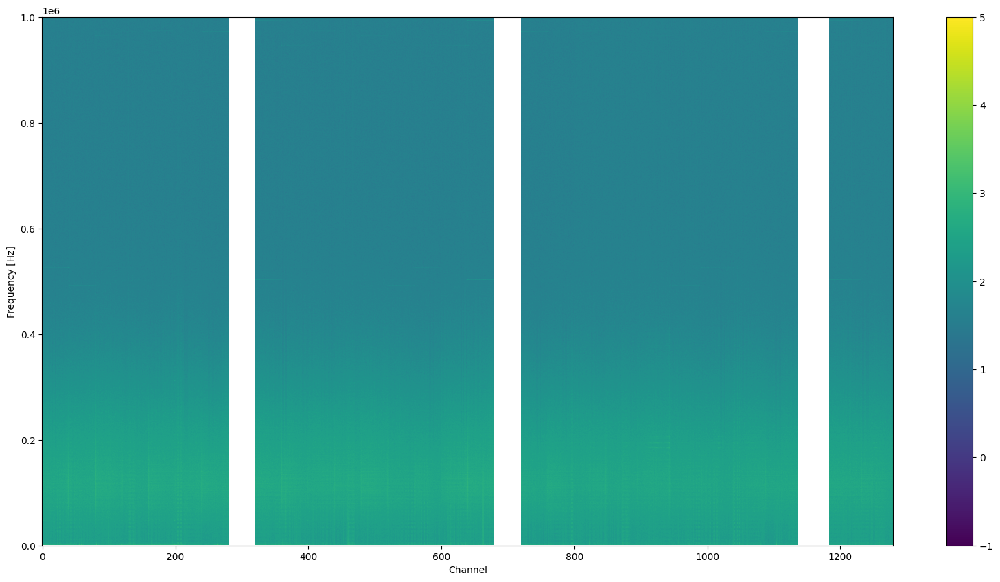

(1281,)
(1066,)
(1280, 1065)


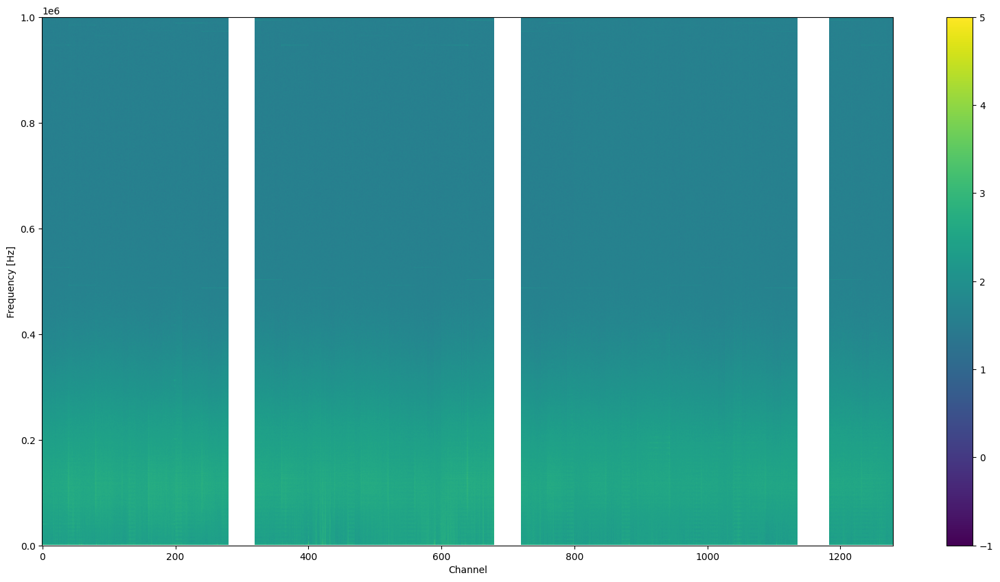

In [6]:
Analyzer.Plot2DFFT(AverageFFTNoCosmics,vmax=5)
Analyzer.Plot2DFFT(AverageFFTWithCosmics,vmax=5)

(1281,)
(1066,)
(1280, 1065)


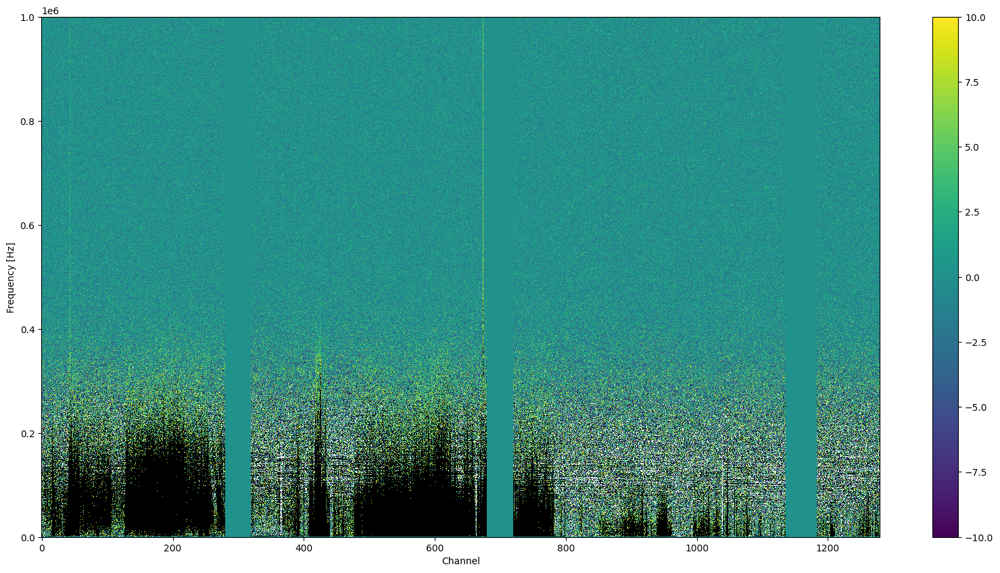

/tmp/ipykernel_4020366/2451156405.py:5: RuntimeWarning: invalid value encountered in divide
  fractional_difference = (AverageFFTWithCosmics-AverageFFTNoCosmics)/AverageFFTNoCosmics


Minimum: -0.13704885656334523
Maximum: 4.263508095711147
(1281,)
(1066,)
(1280, 1065)


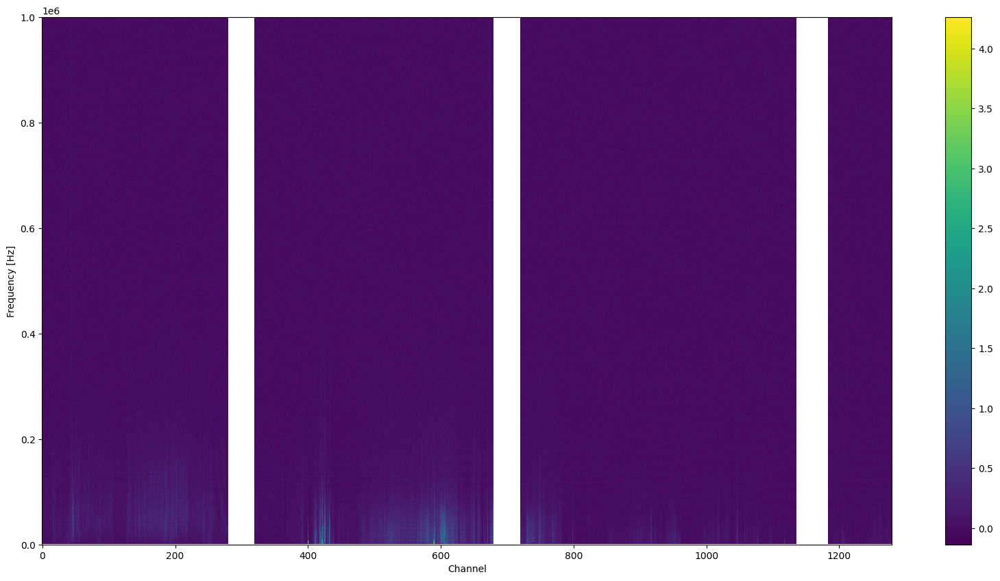

(1281,)
(1066,)
(1280, 1065)


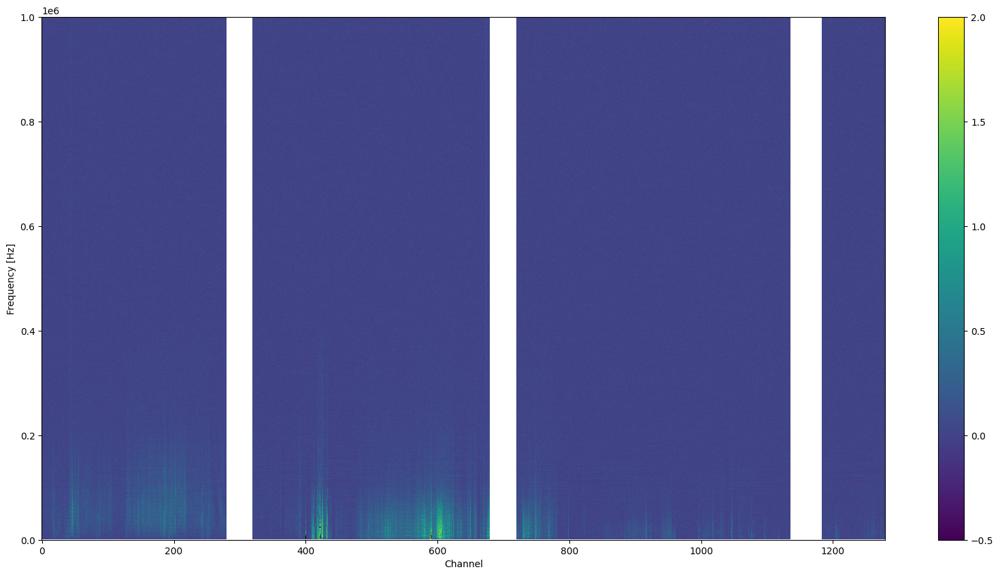

In [7]:
#Plot the difference between the two using the Analyzer.Plot2DFFT function
Analyzer.Plot2DFFT(AverageFFTWithCosmics-AverageFFTNoCosmics,vmin=-10,vmax=10,log=False)

#Plot the fractional difference of the two using the Analyzer.Plot2DFFT function
fractional_difference = (AverageFFTWithCosmics-AverageFFTNoCosmics)/AverageFFTNoCosmics
#Let minimum be the minimum value of the fractional difference where the fractional difference is not nan
minimum = np.min(fractional_difference[np.logical_not(np.isnan(fractional_difference))])
#Let maximum be the maximum value of the fractional difference where the fractional difference is not nan
maximum = np.max(fractional_difference[np.logical_not(np.isnan(fractional_difference))])
#print mimimum and maximum
print('Minimum:',minimum)
print('Maximum:',maximum)


Analyzer.Plot2DFFT(fractional_difference,vmin=minimum,vmax=maximum,log=False)
Analyzer.Plot2DFFT(fractional_difference,vmin=-0.5,vmax=2,log=False)

In [8]:
NoCosmics = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/AverageFFT_No_Cosmics.npz')
print(NoCosmics.keys())
NoCosmicsNEvents = NoCosmics['nEvents']
print(NoCosmicsNEvents)

KeysView(NpzFile '/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/AverageFFT_No_Cosmics.npz' with keys: FFT, nEvents)
48


In [9]:
#Perform the ADC-mV calibration

ADC_Bits=14
dynamic_range=1400 #mV
ADC_to_mV = dynamic_range/(2**ADC_Bits)

#Convert the AverageFFTNoCosmics to mV
AverageFFTNoCosmics_mV = AverageFFTNoCosmics*ADC_to_mV

#Write to a new npz file
np.savez('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/AverageFFT_No_Cosmics_mV.npz',FFT=AverageFFTNoCosmics_mV,nEvents=NoCosmicsNEvents)

In [14]:
#In this cell, we will replace an empty FEMB with the data from another FEMB

# Which channels are all 0?
# Sum over the frequency axis
Summed = np.sum(AverageFFTNoCosmics_mV,axis=1)
# Find the channels where the sum is 0
ZeroChannels = np.where(Summed==0)
print(ZeroChannels)

#Based on the ICEBERG channel mapping, this corresponds to the following FEMB:
#FEMB 8

#Fill in these zero channels (FEMB 8) with FEMB 1, arbitrarily
#That means replace channels 280->319 with channels 160->199
#And replace channels 680->719 with channels 400->439
#And replace channels 1136->1183with channels 800->847

#Copy the AverageFFTNoCosmics_mV to a new array
AverageFFTNoCosmics_mV_Filled = np.copy(AverageFFTNoCosmics_mV)
#Apply the replacements
AverageFFTNoCosmics_mV_Filled[280:320] = AverageFFTNoCosmics_mV[160:200]
AverageFFTNoCosmics_mV_Filled[680:720] = AverageFFTNoCosmics_mV[400:440]
AverageFFTNoCosmics_mV_Filled[1136:1184] = AverageFFTNoCosmics_mV[800:848]

#Save as a new npz file:
np.savez('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz',FFT=AverageFFTNoCosmics_mV_Filled,nEvents=NoCosmicsNEvents)



(array([ 280,  281,  282,  283,  284,  285,  286,  287,  288,  289,  290,
        291,  292,  293,  294,  295,  296,  297,  298,  299,  300,  301,
        302,  303,  304,  305,  306,  307,  308,  309,  310,  311,  312,
        313,  314,  315,  316,  317,  318,  319,  680,  681,  682,  683,
        684,  685,  686,  687,  688,  689,  690,  691,  692,  693,  694,
        695,  696,  697,  698,  699,  700,  701,  702,  703,  704,  705,
        706,  707,  708,  709,  710,  711,  712,  713,  714,  715,  716,
        717,  718,  719, 1136, 1137, 1138, 1139, 1140, 1141, 1142, 1143,
       1144, 1145, 1146, 1147, 1148, 1149, 1150, 1151, 1152, 1153, 1154,
       1155, 1156, 1157, 1158, 1159, 1160, 1161, 1162, 1163, 1164, 1165,
       1166, 1167, 1168, 1169, 1170, 1171, 1172, 1173, 1174, 1175, 1176,
       1177, 1178, 1179, 1180, 1181, 1182, 1183]),)


KeysView(NpzFile '/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz' with keys: FFT, nEvents)
48
(1281,)
(1066,)
(1280, 1065)


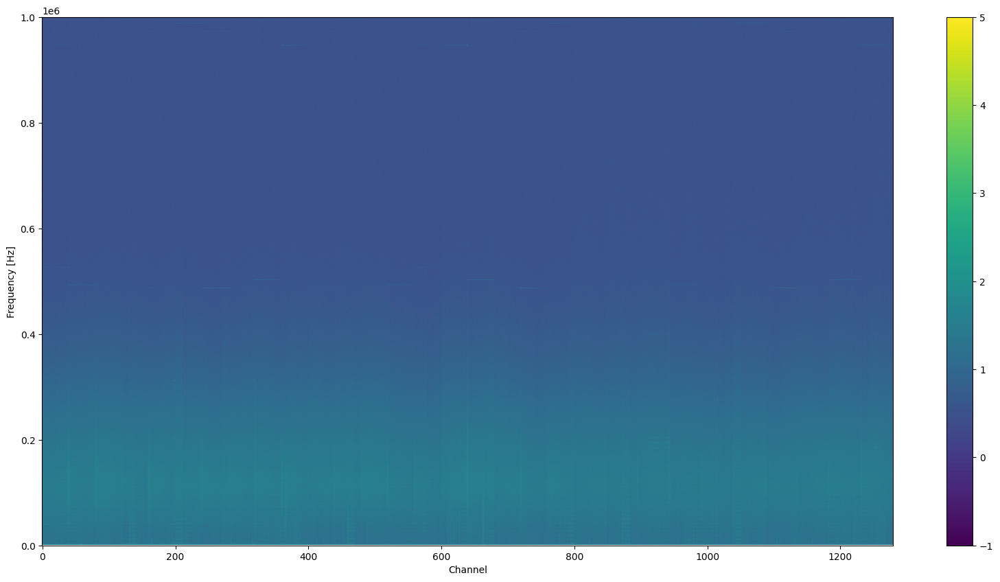

/tmp/ipykernel_4020366/1837585951.py:15: RuntimeWarning: divide by zero encountered in divide
  Analyzer.Plot2DFFT(Final['FFT']/AverageFFTNoCosmics,vmin=-4,vmax=4,log=True)
/tmp/ipykernel_4020366/1837585951.py:15: RuntimeWarning: invalid value encountered in divide
  Analyzer.Plot2DFFT(Final['FFT']/AverageFFTNoCosmics,vmin=-4,vmax=4,log=True)


(1281,)
(1066,)
(1280, 1065)


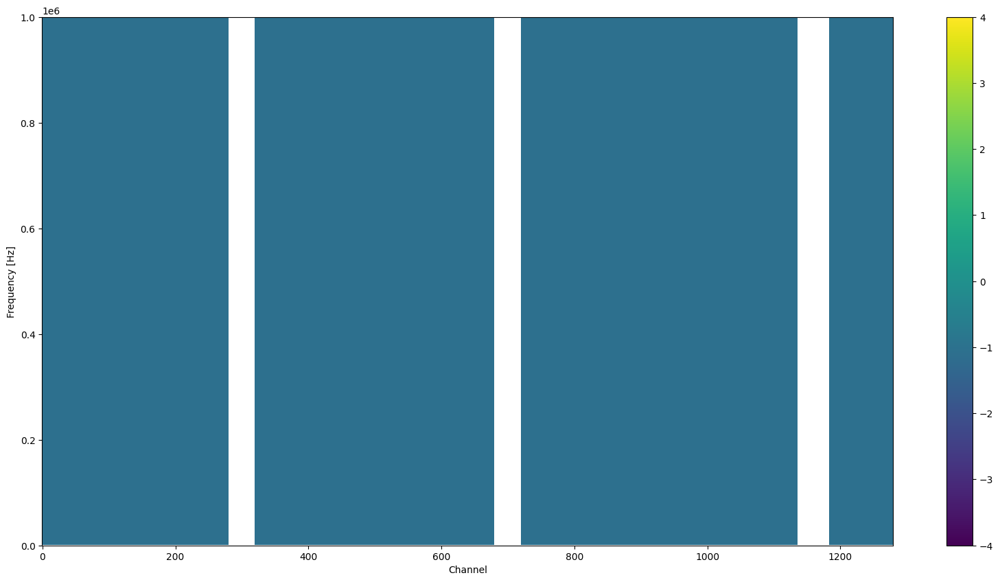

0.08544921875


In [18]:
#Double-check the final npz file:
#Plot the 2D FFT of the final npz file
#Check nEvents

#Load the final npz file
Final = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz')
print(Final.keys())
FinalNEvents = Final['nEvents']
print(FinalNEvents)

#Plot the 2D FFT of the final npz file
Analyzer.Plot2DFFT(Final['FFT'],vmax=5)

#Also plot the ratio between the final and the original to ensure that I did the ADC-mV conversion correctly
Analyzer.Plot2DFFT(Final['FFT']/AverageFFTNoCosmics,vmin=-4,vmax=4,log=True)

#print a value from that ratio and make sure it matches the conversion factor
print(Final['FFT'][100,100]/AverageFFTNoCosmics[100,100])


In [19]:
print(1400/2**14)

0.08544921875


In [12]:
#Debugging the convert file
nch, nfreq = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz')['FFT'].shape
print(nch,nfreq)

1280 1065


In [1]:
#renaming the key nEvents in the npz file to N
#Adding a key 'freq' to the npz file which is a list of the frequency values which are the same for all channels
import numpy as np

#Load the npz file
npzfile = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz')
#Get the FFT array
FFT = npzfile['FFT']
#Get the nEvents
nEvents = npzfile['nEvents']
#Get the shape of the FFT array
nch, nfreq = FFT.shape
#Create a list of the frequency values
N = 2128
Seconds_Per_Timetick = 0.5e-6
freq = np.fft.rfftfreq(N,Seconds_Per_Timetick)

#Save the new npz file
np.savez('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz',FFT=FFT,N=N,freq=freq)


KeysView(NpzFile '/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz' with keys: FFT, N, freq)
2128
[0.00000000e+00 9.39849624e+02 1.87969925e+03 ... 9.98120301e+05
 9.99060150e+05 1.00000000e+06]
(1280, 1065)
(1281,)
(1066,)
(1280, 1065)


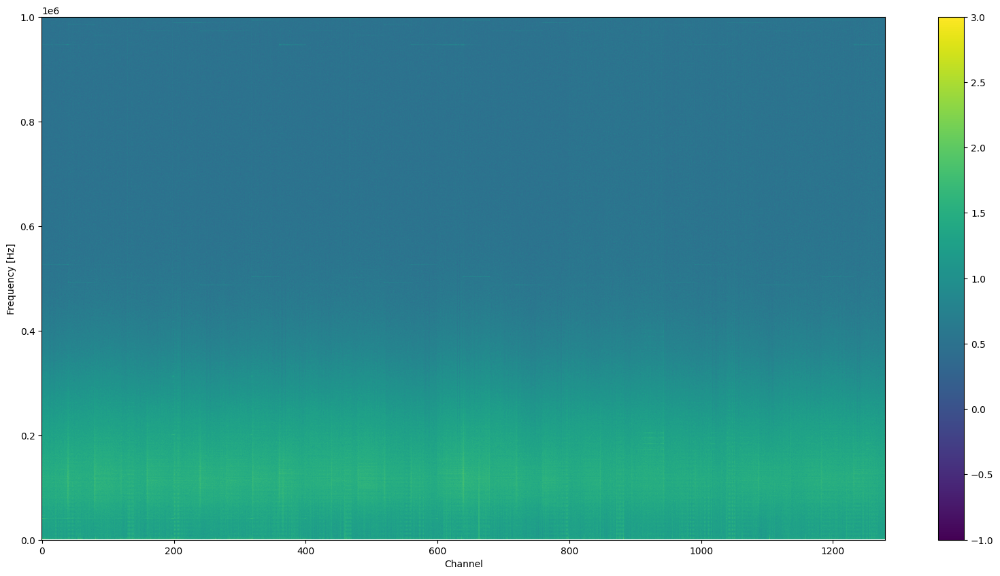

In [11]:
#Check that the new npz file has the correct keys
npzfile = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/ICEBERG_Noise_Model_For_Wirecell.npz')
print(npzfile.keys())

#Check that the new npz file has the correct values
print(npzfile['N'])
print(npzfile['freq'])

#Check that the new npz file has the correct shape
print(npzfile['FFT'].shape)

#Using the Analyzer module, plot the FFT of the new npz file
from Analyzer import Analyzer
Analyzer.Plot2DFFT(npzfile['FFT'],vmax=3)

In [2]:
#Create the noise model in json.bz2 format
#Do this simply by running the following command:

!python3 convert_iceberg_noise_model.py

(1281,)
(1066,)
(1280, 1065)


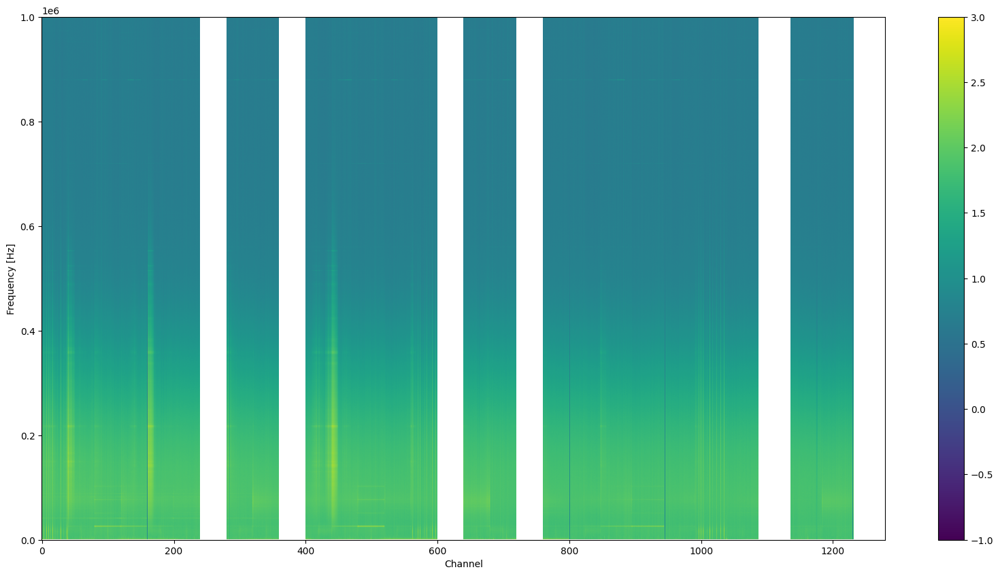

In [12]:
#Let's also plot the old noise model to compare
OldNoiseModel = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Sim_Validation_04192024/Data_Full_Plots/NoiseModel_FFT_05_15_2024.npz')

#Plot the 2D FFT of the old noise model
Analyzer.Plot2DFFT(OldNoiseModel['PSD']*1400/2**14,vmax=3)

In [1]:
#Now let's compare with the FFT of the simulated data to make sure the simulation matches the noise model

from Analyzer import Analyzer
import numpy as np
import uproot as uproot

datapath = '/exp/dune/data/users/mking/'
inputwaveformlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/'
inputfilename = 'Waveforms_Sim.root'
outputfftlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/'
outputfilename = 'AverageFFT_Sim.npz'

Waveform_File_Path = datapath + inputwaveformlocation + inputfilename

infile = uproot.open(Waveform_File_Path)
print(infile.keys())
print(np.shape(infile.keys()))



['run_1_sub_0_event_1_daq;1', 'run_1_sub_0_event_1_sig;1', 'run_1_sub_0_event_2_daq;1', 'run_1_sub_0_event_2_sig;1', 'run_1_sub_0_event_3_daq;1', 'run_1_sub_0_event_3_sig;1', 'run_1_sub_0_event_4_daq;1', 'run_1_sub_0_event_4_sig;1', 'run_1_sub_0_event_5_daq;1', 'run_1_sub_0_event_5_sig;1', 'run_1_sub_0_event_6_daq;1', 'run_1_sub_0_event_6_sig;1', 'run_1_sub_0_event_7_daq;1', 'run_1_sub_0_event_7_sig;1', 'run_1_sub_0_event_8_daq;1', 'run_1_sub_0_event_8_sig;1', 'run_1_sub_0_event_9_daq;1', 'run_1_sub_0_event_9_sig;1', 'run_1_sub_0_event_10_daq;1', 'run_1_sub_0_event_10_sig;1', 'run_1_sub_0_event_11_daq;1', 'run_1_sub_0_event_11_sig;1', 'run_1_sub_0_event_12_daq;1', 'run_1_sub_0_event_12_sig;1', 'run_1_sub_0_event_13_daq;1', 'run_1_sub_0_event_13_sig;1', 'run_1_sub_0_event_14_daq;1', 'run_1_sub_0_event_14_sig;1', 'run_1_sub_0_event_15_daq;1', 'run_1_sub_0_event_15_sig;1', 'run_1_sub_0_event_16_daq;1', 'run_1_sub_0_event_16_sig;1', 'run_1_sub_0_event_17_daq;1', 'run_1_sub_0_event_17_sig;1

In [12]:
#Plot a waveform
from Analyzer import Analyzer
import numpy as np
import uproot as uproot
infile = uproot.open(Waveform_File_Path)
key = infile.keys()[0] #only take first daq channel
H, xedges, yedges = infile[key].to_numpy()

#Baseline subtract
H_subtr = H - np.mean(H[:,0:2128],axis=1)[:,np.newaxis]


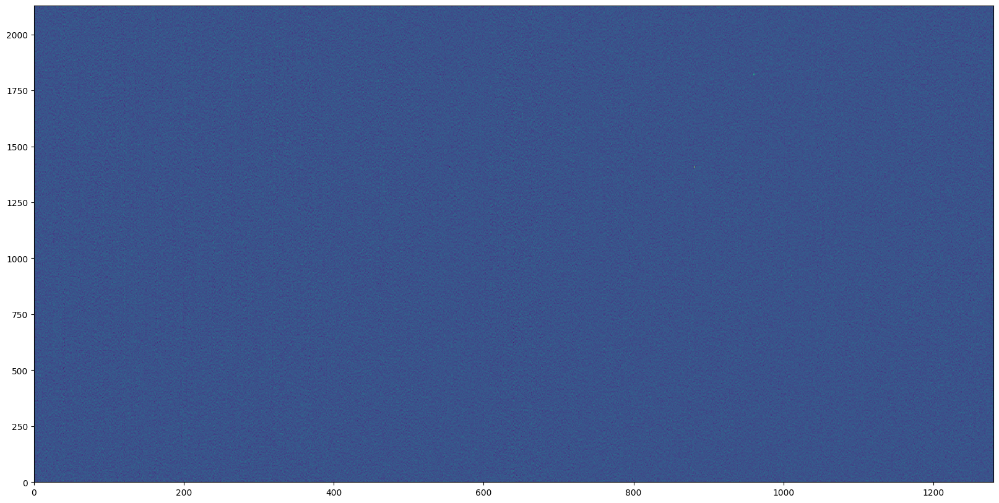

In [18]:
import matplotlib.pyplot as plt
fig2,ax2 = plt.subplots(1,figsize=(20,10))
pc2 = ax2.pcolorfast(xedges,yedges,H_subtr.T)
#plt.xlim(2080,2105)
#plt.ylim(1140,1220)
plt.show()

In [3]:
from Analyzer import Analyzer
import numpy as np
AverageFFT = Analyzer.AverageFFT(OutputFFT_File_Path = datapath+outputfftlocation+outputfilename, Waveform_File_Path=datapath + inputwaveformlocation + inputfilename,nEvents = 50)

0
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
1
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
2
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
3
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
4
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
5
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
6
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
7
Opening file:  /exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/10_02_2024/Waveforms_Sim.root
8
Opening file:  /exp/dune/data/users/mking/ICEBERG_Nois

(1281,)
(1066,)
(1280, 1065)


/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/Analyzer.py:212: RuntimeWarning: divide by zero encountered in log10
  FFT = np.log10(FFT)


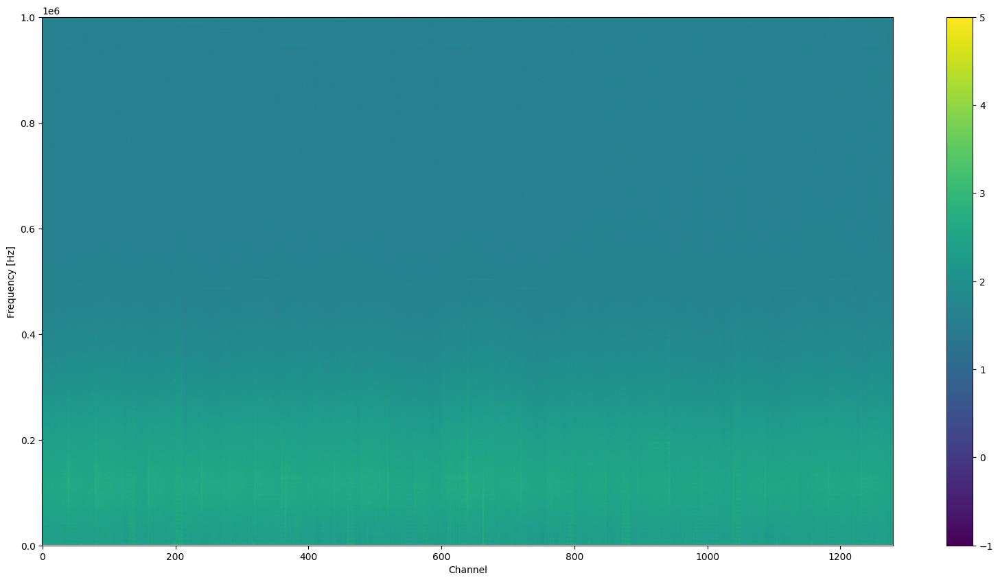

In [4]:
#Plot this fft
sim_file = np.load("AverageFFT_Sim.npz")
Analyzer.Plot2DFFT(sim_file['FFT'],vmax=5)

(1281,)
(1066,)
(1280, 1065)


/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/Analyzer.py:212: RuntimeWarning: divide by zero encountered in log10
  FFT = np.log10(FFT)


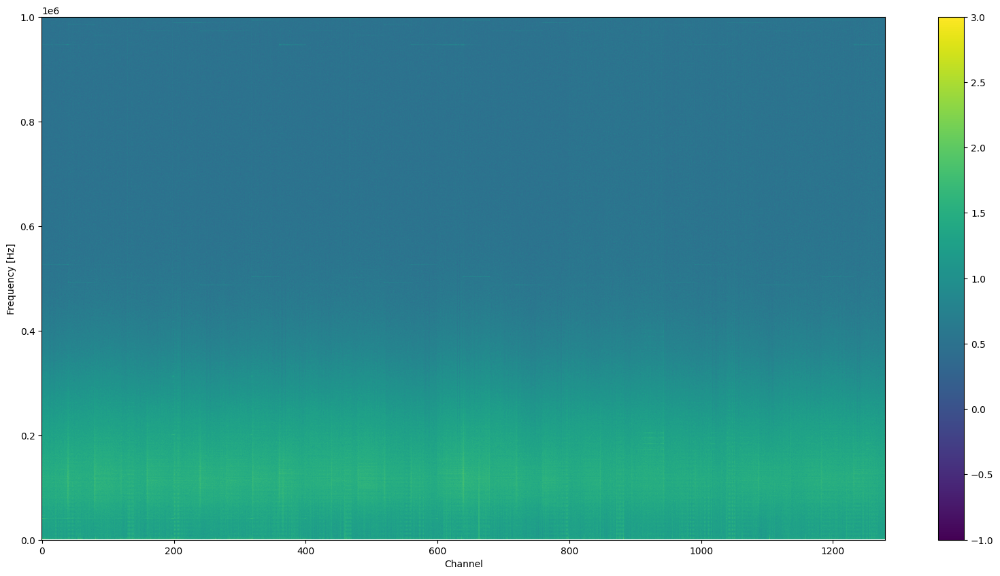

In [3]:
import numpy as np
from Analyzer import Analyzer
file = np.load("ICEBERG_Noise_Model_For_Wirecell.npz")
Analyzer.Plot2DFFT(file['FFT'],vmax=3)

(1281,)
(1066,)
(1280, 1065)


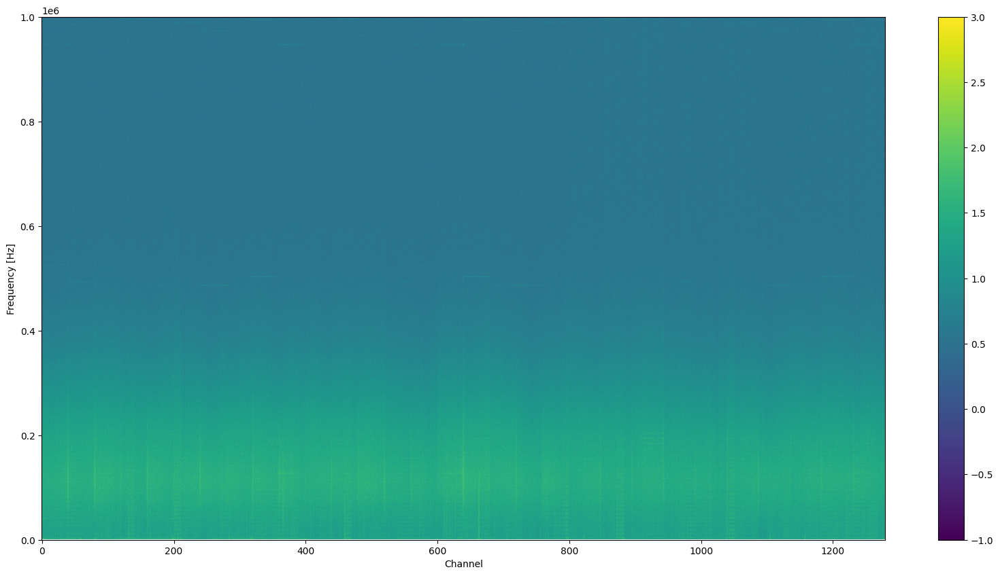

(1281,)
(1066,)
(1280, 1065)


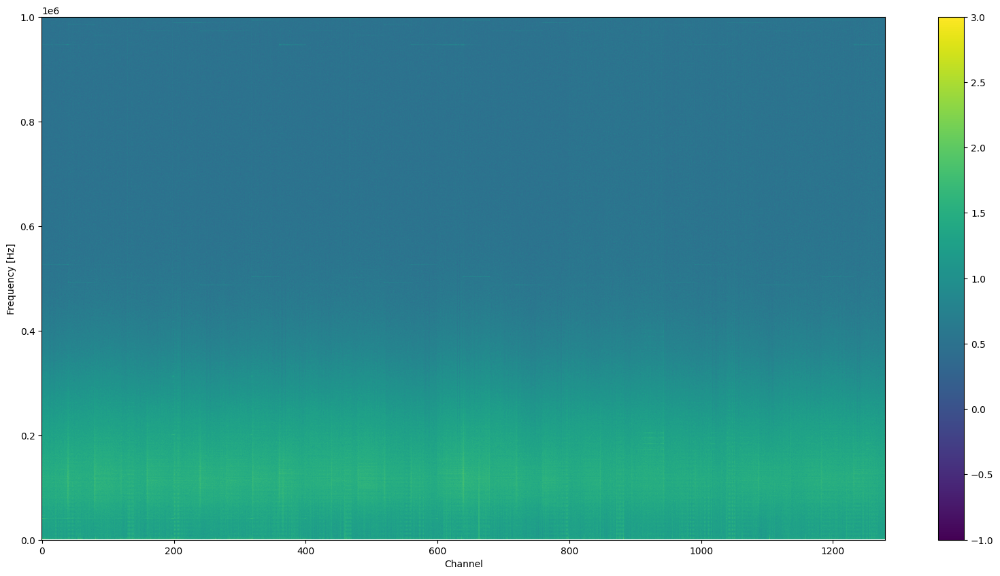

In [4]:
#Scale the simulated data to match the noise model
sim_file = np.load("AverageFFT_Sim.npz")
Sim_FFT_mV = sim_file['FFT']*1400/2**14

Analyzer.Plot2DFFT(Sim_FFT_mV,vmax=3)
Analyzer.Plot2DFFT(file['FFT'],vmax=3)

/tmp/ipykernel_2621225/2997396967.py:2: RuntimeWarning: invalid value encountered in divide
  fractional_difference = (Sim_FFT_mV-file['FFT'])/file['FFT']


Minimum: -0.37515507124895225
Maximum: 0.7721841004184101
(1281,)
(1066,)
(1280, 1065)


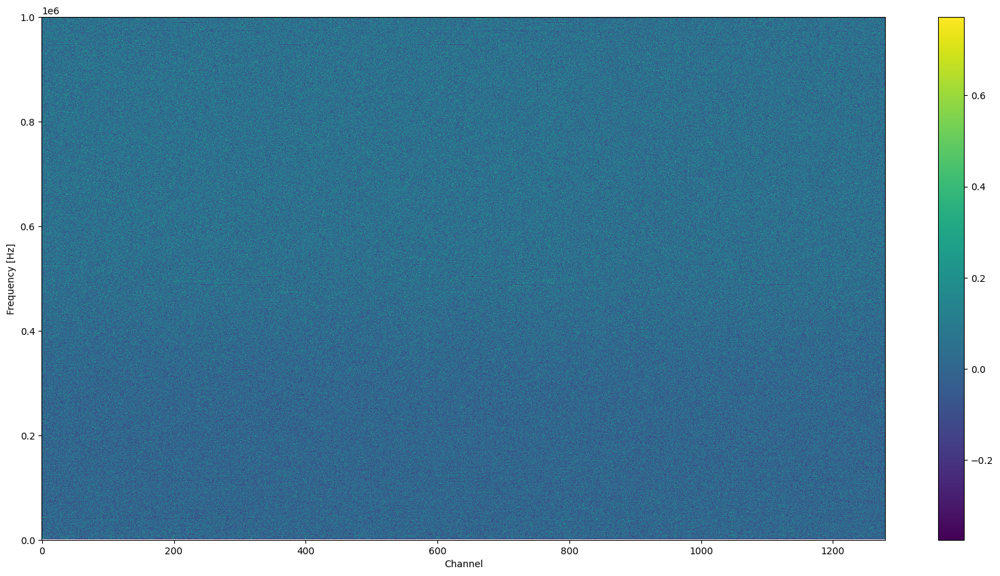

(1281,)
(1066,)
(1280, 1065)


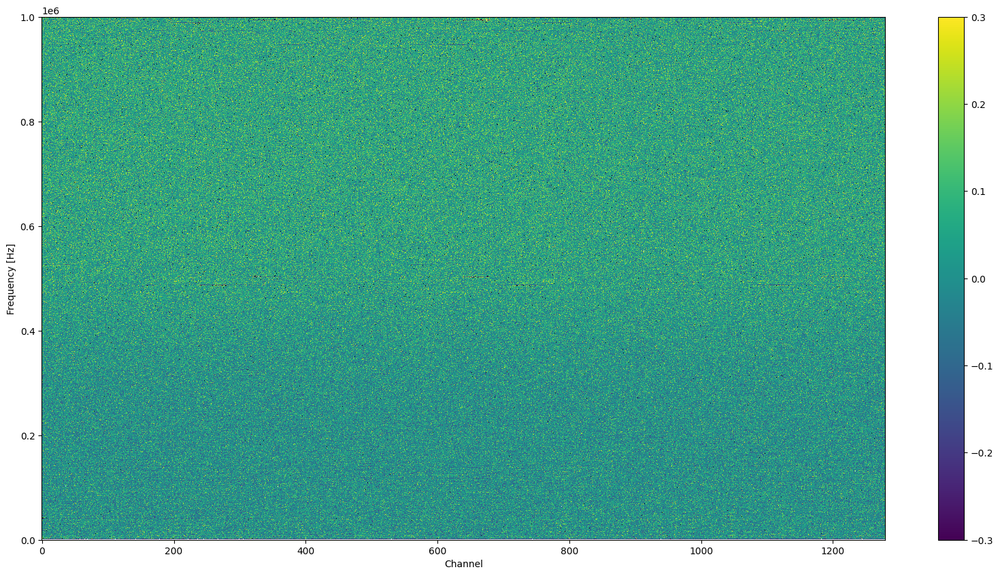

In [5]:
#Plot the fractional difference of the two using the Analyzer.Plot2DFFT function
fractional_difference = (Sim_FFT_mV-file['FFT'])/file['FFT']
#Let minimum be the minimum value of the fractional difference where the fractional difference is not nan
minimum = np.min(fractional_difference[np.logical_not(np.isnan(fractional_difference))])
#Let maximum be the maximum value of the fractional difference where the fractional difference is not nan
maximum = np.max(fractional_difference[np.logical_not(np.isnan(fractional_difference))])
#print mimimum and maximum
print('Minimum:',minimum)
print('Maximum:',maximum)

Analyzer.Plot2DFFT(fractional_difference,vmin=minimum,vmax=maximum,log=False)
Analyzer.Plot2DFFT(fractional_difference,vmin=-0.3,vmax=0.3,log=False)

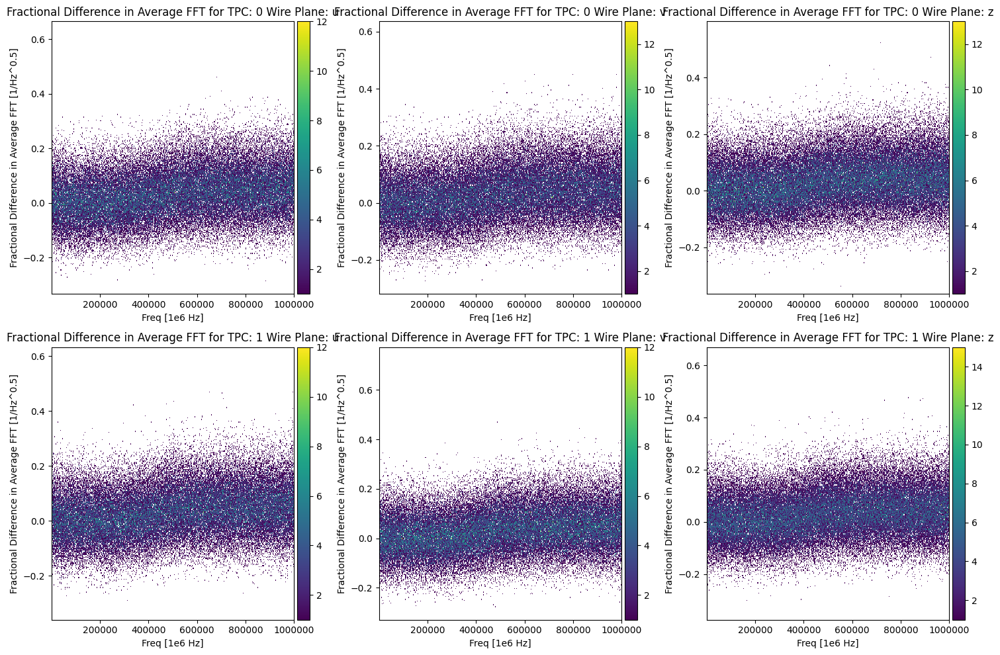

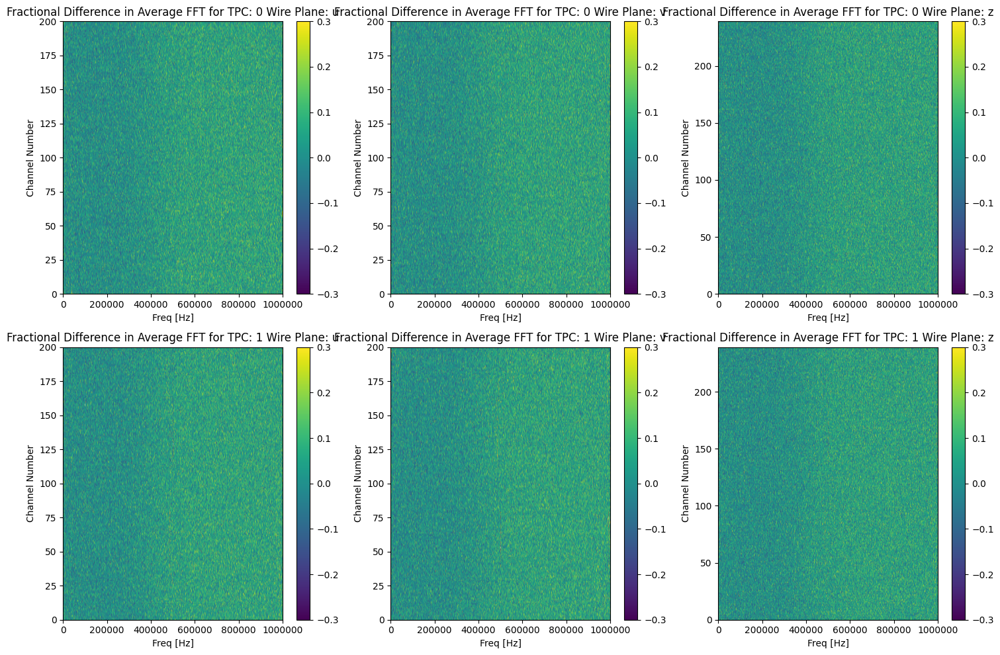

In [7]:
from plotter import plotter
plotter.Hist2DFuncByPlane(fractional_difference,outputFile1 = 'FuncHisto.png',outputFile2 = 'Func2D.png',logmode = False, maxval = 0.3, minval = -0.3,funclabel = "Fractional Difference in Average FFT",units = "1/Hz^0.5")

(1281,)
(1066,)
(1280, 1065)


/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/Analyzer.py:212: RuntimeWarning: divide by zero encountered in log10
  FFT = np.log10(FFT)


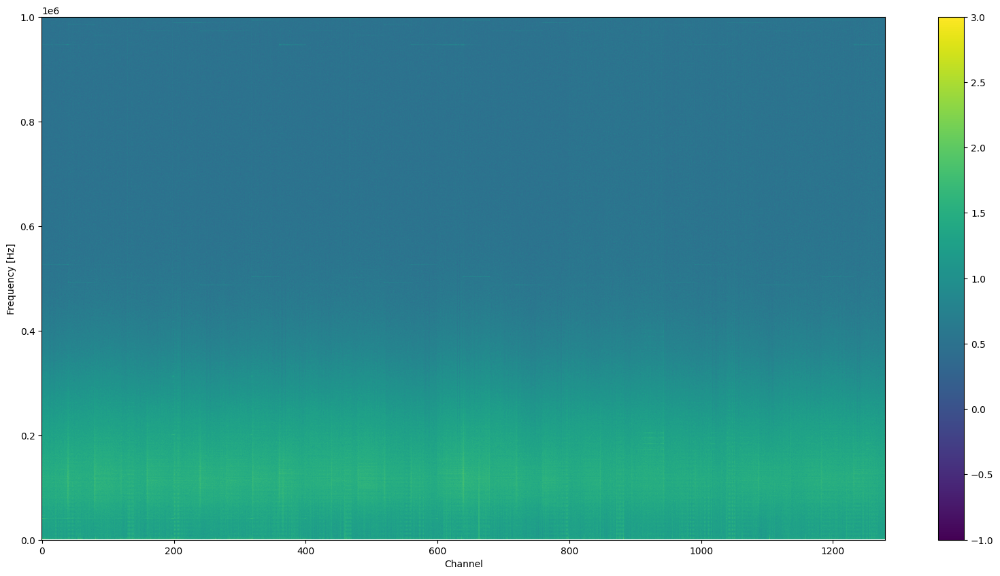

/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/plotter.py:213: RuntimeWarning: divide by zero encountered in log10
  ax2[tpc][plane].set_ylabel("Channel Number")


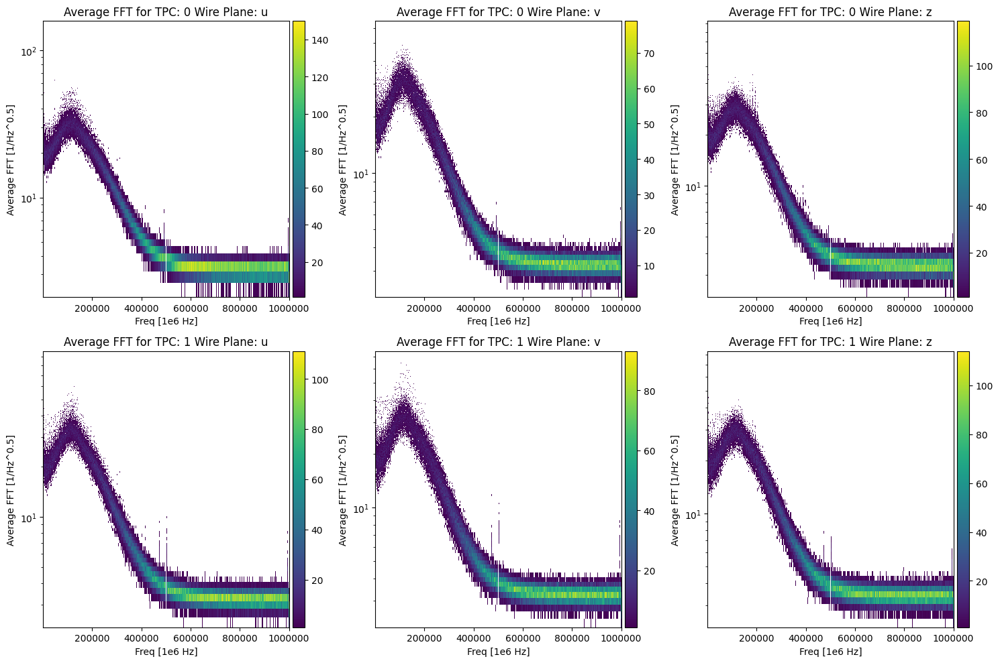

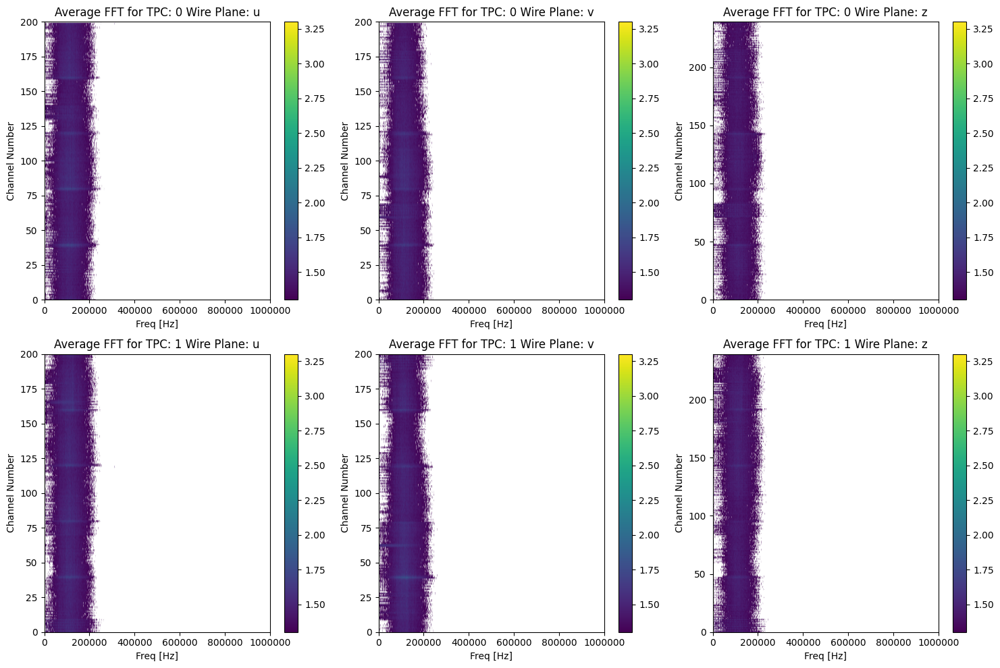

(1281,)
(1066,)
(1280, 1065)


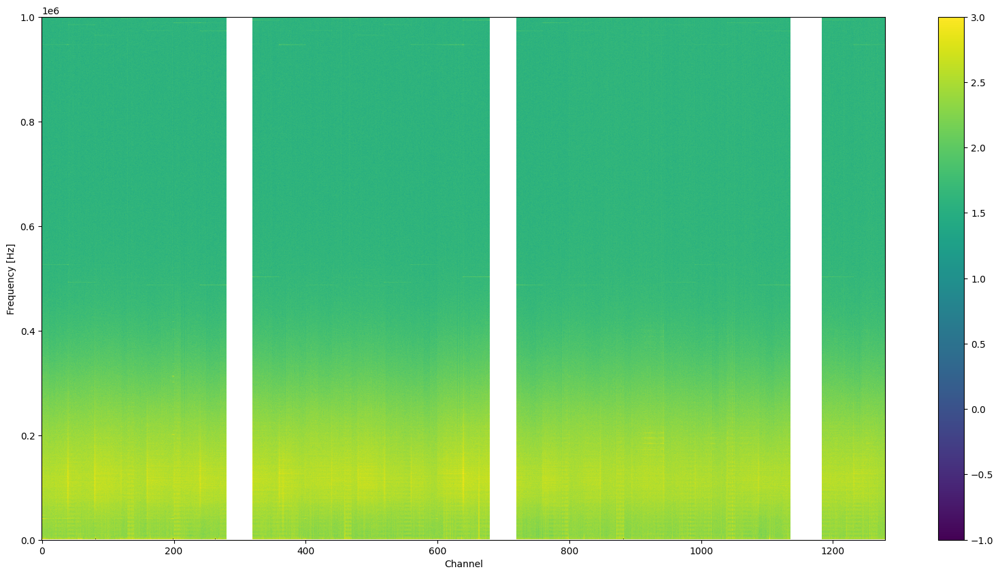

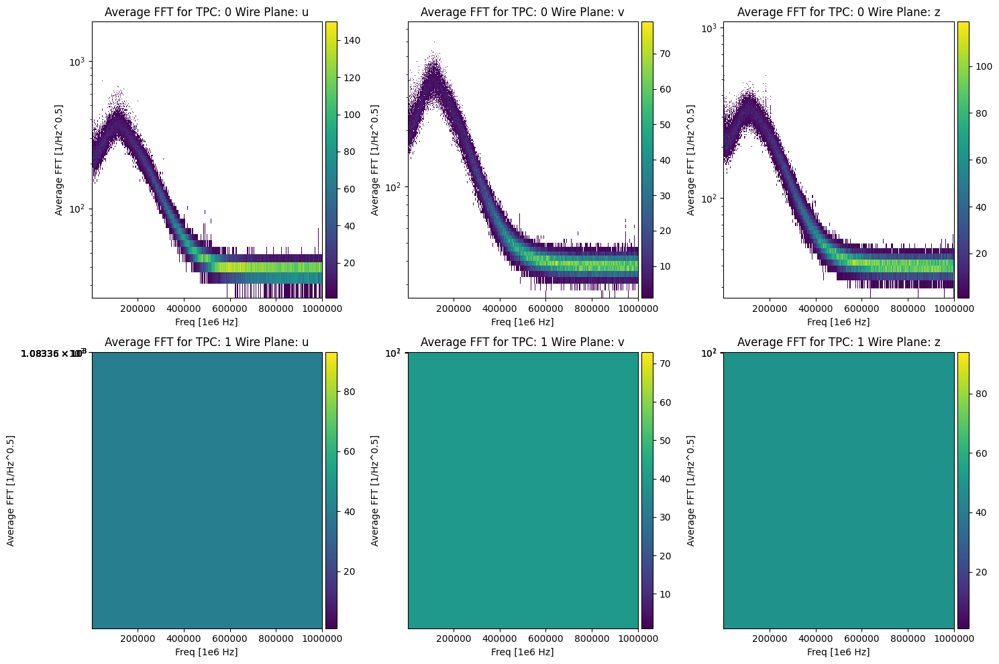

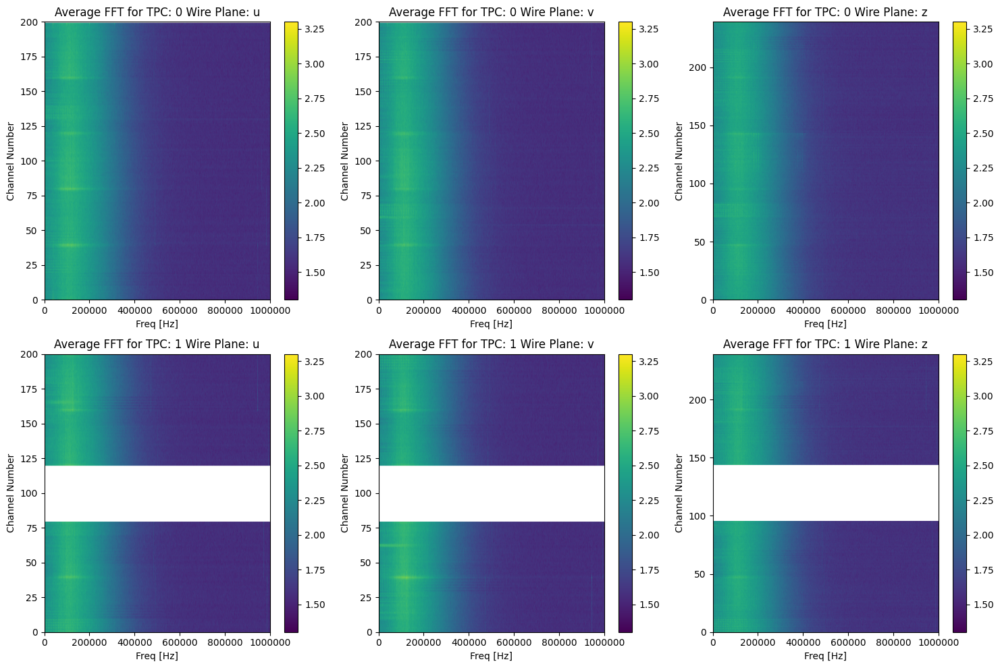

In [25]:
import numpy as np
from Analyzer import Analyzer
from plotter import plotter
file = np.load("ICEBERG_Noise_Model_For_Wirecell.npz")
AverageFFTNoCosmics = np.load('/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/AverageFFT_No_Cosmics.npz')['FFT']
Analyzer.Plot2DFFT(file['FFT'],vmax=3)
plotter.Hist2DFuncByPlane(file['FFT'],outputFile1 = 'NoiseModelHisto.png',outputFile2 = 'NoiseModel2D.png',logmode = True, maxval = 3.3, minval = 1.3,funclabel = "Average FFT",units = "1/Hz^0.5")
Analyzer.Plot2DFFT(AverageFFTNoCosmics,vmax=3)
plotter.Hist2DFuncByPlane(AverageFFTNoCosmics,outputFile1 = 'AvgFFTNoCosmics.png',outputFile2 = 'AvgFFTNoCosmics.png',logmode = True, maxval = 3.3, minval = 1.3,funclabel = "Average FFT",units = "1/Hz^0.5")

In [ ]:
def Hist2DFuncByPlane(Func, outputFile1='FuncHisto.svg', outputFile2='Func2D.svg', logmode=False, maxval=1, minval=-1, funclabel="Average FFT", units="1/Hz^0.5"):
    import matplotlib as mpl
    import matplotlib.pyplot as plt
    from mpl_toolkits.axes_grid1 import make_axes_locatable

    fig, ax = plt.subplots(plotter.numtpcs, plotter.numplanes, num=1, figsize=(5 * plotter.numplanes, 5 * plotter.numtpcs))
    fig2, ax2 = plt.subplots(plotter.numtpcs, plotter.numplanes, num=2, figsize=(5 * plotter.numplanes, 5 * plotter.numtpcs))

    fig.suptitle("Histogram of Average Absolute FFT for 48 Noise Events", fontsize=20)
    fig2.suptitle("Average Absolute FFT for 48 Noise Events", fontsize=20)

    planenames = ["u", "v", "z"]
    Sorted_Func = plotter.convert_to_sorted(Func)

    cmap = mpl.cm.viridis
    cmap.set_under('white')

    for tpc in range(plotter.numtpcs):
        for plane in range(plotter.numplanes):
            freq = np.fft.rfftfreq(plotter.minwvfm, plotter.SampleSpacing)

            SanitizedFunc = Sorted_Func[tpc][plane][:, 1:]
            if plane != 2:
                SanitizedFunc = SanitizedFunc[:200]

            SanitizedFunc = SanitizedFunc[~np.isnan(SanitizedFunc).all(axis=1)]

            longFuncHist = SanitizedFunc.flatten()
            longFreq = np.tile(freq[1:], len(SanitizedFunc))

            Data = np.log10(Sorted_Func[tpc][plane]) if logmode else Sorted_Func[tpc][plane]

            pcm = ax2[tpc][plane].pcolormesh(freq * 1e-6, range(plotter.maxwires), Data, cmap=cmap, shading='gouraud', vmin=minval, vmax=maxval)

            cbar = fig2.colorbar(pcm, ax=ax2[tpc][plane])

            if logmode:
                cbar.set_ticks(np.log10(np.geomspace(10**minval, 10**maxval, num=5)))
                cbar.set_ticklabels([f"{10**x:.1e}" for x in np.log10(np.geomspace(10**minval, 10**maxval, num=5))])

            if plane != 2:
                ax2[tpc][plane].set_ylim(0, 200)

            h = ax[tpc][plane].hist2d(longFreq * 1e-6, longFuncHist, bins=[1065, 300], cmap=cmap, vmin=1)

            ax[tpc][plane].set_ylim(0, 800)  # Set y-axis limit to 0-800

            divider = make_axes_locatable(ax[tpc][plane])
            cax = divider.append_axes('right', size='5%', pad=0.05)
            fig.colorbar(h[3], cax=cax)

            ax[tpc][plane].set_yscale("linear")
            ax[tpc][plane].set_xlabel("Freq [MHz]")
            ax[tpc][plane].set_ylabel(f"{funclabel} [{units}]")
            ax[tpc][plane].set_title(f"{funclabel} for TPC: {tpc} Wire Plane: {planenames[plane]}")

            ax2[tpc][plane].set_xscale("linear")
            ax2[tpc][plane].set_xlabel("Freq [MHz]", fontsize=14)
            ax2[tpc][plane].set_ylabel("Channel Number", fontsize=14)
            ax2[tpc][plane].set_title(f"{funclabel} for TPC: {tpc} Wire Plane: {planenames[plane]}", fontsize=14)

    fig.tight_layout()
    fig2.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    fig.savefig(outputFile1, dpi=300)
    fig2.savefig(outputFile2, dpi=300)

/tmp/ipykernel_2220189/582451636.py:31: RuntimeWarning: divide by zero encountered in log10
  Data = np.log10(Sorted_Func[tpc][plane]) if logmode else Sorted_Func[tpc][plane]
/tmp/ipykernel_2220189/582451636.py:31: RuntimeWarning: divide by zero encountered in log10
  Data = np.log10(Sorted_Func[tpc][plane]) if logmode else Sorted_Func[tpc][plane]
/tmp/ipykernel_2220189/582451636.py:31: RuntimeWarning: divide by zero encountered in log10
  Data = np.log10(Sorted_Func[tpc][plane]) if logmode else Sorted_Func[tpc][plane]
/tmp/ipykernel_2220189/582451636.py:31: RuntimeWarning: divide by zero encountered in log10
  Data = np.log10(Sorted_Func[tpc][plane]) if logmode else Sorted_Func[tpc][plane]
/tmp/ipykernel_2220189/582451636.py:31: RuntimeWarning: divide by zero encountered in log10
  Data = np.log10(Sorted_Func[tpc][plane]) if logmode else Sorted_Func[tpc][plane]
/tmp/ipykernel_2220189/582451636.py:31: RuntimeWarning: divide by zero encountered in log10
  Data = np.log10(Sorted_Func[tpc

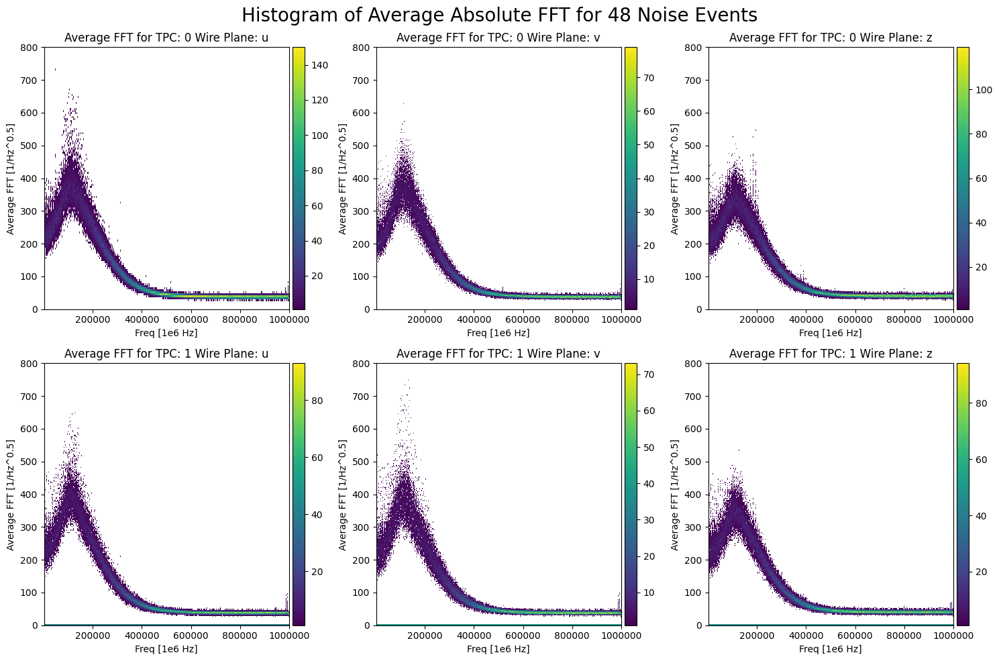

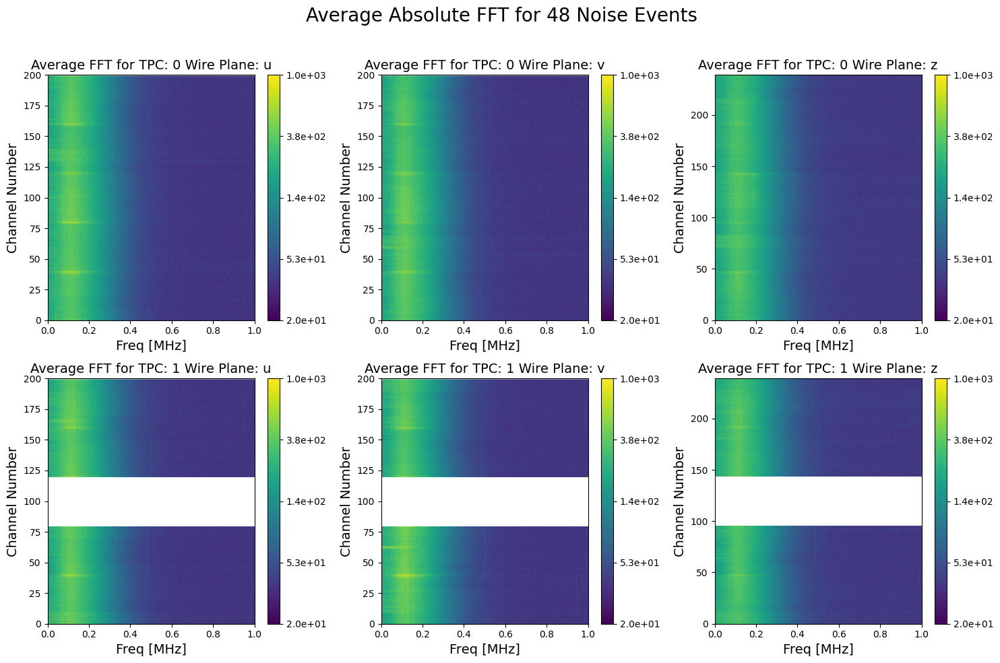

In [43]:
Hist2DFuncByPlane(AverageFFTNoCosmics,outputFile1 = 'AvgFFTNoCosmicsHist.png',outputFile2 = 'AvgFFTNoCosmics2D.png',logmode = True, maxval = 3.0, minval = 1.3,funclabel = "Average FFT",units = "1/Hz^0.5")

In [9]:
from Analyzer import Analyzer
import numpy as np
import uproot as uproot

datapath = '/exp/dune/data/users/mking/'
inputwaveformlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/'
inputfilename = 'Waveforms_Noise_Data.root'
outputfftlocation = 'ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/'
outputfilename = 'AverageFFT_No_Cosmics.npz'

Waveform_File_Path = datapath + inputwaveformlocation + inputfilename

infile = uproot.open(Waveform_File_Path)
print(infile.keys())
print(np.shape(infile.keys()))

['run_13154_sub_1_event_1_daq;1', 'run_13154_sub_1_event_2_daq;1', 'run_13154_sub_1_event_3_daq;1', 'run_13154_sub_1_event_4_daq;1', 'run_13154_sub_1_event_5_daq;1', 'run_13154_sub_1_event_6_daq;1', 'run_13154_sub_1_event_7_daq;1', 'run_13154_sub_1_event_8_daq;1', 'run_13154_sub_1_event_9_daq;1', 'run_13154_sub_1_event_10_daq;1', 'run_13154_sub_1_event_11_daq;1', 'run_13154_sub_1_event_12_daq;1', 'run_13154_sub_1_event_13_daq;1', 'run_13154_sub_1_event_14_daq;1', 'run_13154_sub_1_event_15_daq;1', 'run_13154_sub_1_event_16_daq;1', 'run_13154_sub_1_event_17_daq;1', 'run_13154_sub_1_event_18_daq;1', 'run_13154_sub_1_event_19_daq;1', 'run_13154_sub_1_event_20_daq;1', 'run_13154_sub_1_event_21_daq;1', 'run_13154_sub_1_event_22_daq;1', 'run_13154_sub_1_event_23_daq;1', 'run_13154_sub_1_event_24_daq;1', 'run_13154_sub_1_event_25_daq;1', 'run_13154_sub_1_event_26_daq;1', 'run_13154_sub_1_event_27_daq;1', 'run_13154_sub_1_event_28_daq;1', 'run_13154_sub_1_event_29_daq;1', 'run_13154_sub_1_event

In [2]:
print(len(infile.keys()))

62


In [10]:
keys = infile.keys()
CosmicEvents = [2,4,6,14,21,26,29,34,35,39,43,44,47,59]
denominator = len(infile.keys()) - len(CosmicEvents)
print(denominator)
Noise = np.zeros((48,1280,2128),dtype=np.float32)
CorrMatrix = np.zeros((1280,1280),dtype=np.float32)
CorrMatrixOneEvent = np.zeros((1280,1280),dtype=np.float32)
LiveWire = np.ones(1280)
BothLive = np.zeros((1280,1280),dtype=np.float32)
count=0

for iEvent in range(len(keys)):
    key = keys[iEvent]
    #If iEvent+1 is equal to an element in CosmicEvents, skip that event
    if iEvent+1 in CosmicEvents:
        continue
    H, xedges, yedges = infile[key].to_numpy()
    Noise[count] = H
    CorrMatrix+=np.corrcoef(H)

    if iEvent==0:
        CorrMatrixOneEvent+=np.corrcoef(H)
        LiveWire = np.any(H != 0, axis=1).astype(int)
    count+=1

BothLive = np.outer(LiveWire, LiveWire)
CorrMatrix/=denominator


48


/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/.venv/lib64/python3.9/site-packages/numpy/lib/_function_base_impl.py:2922: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/Update_Noise_Model_09292024/.venv/lib64/python3.9/site-packages/numpy/lib/_function_base_impl.py:2923: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


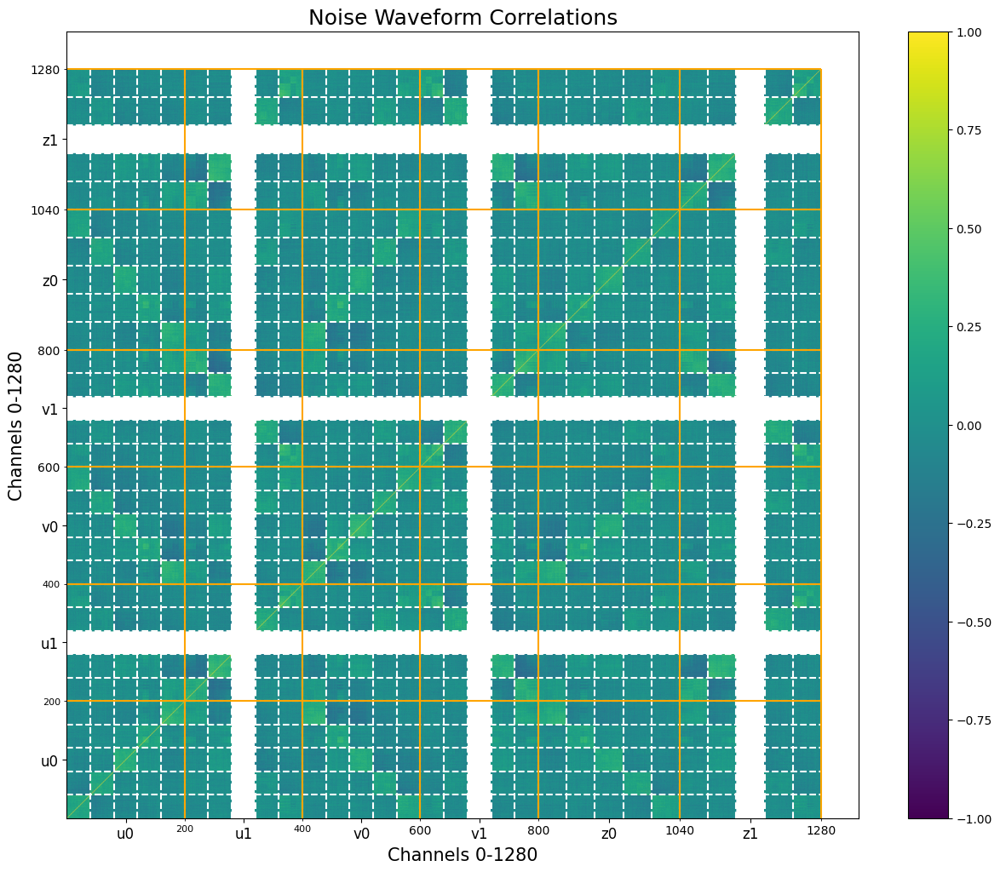

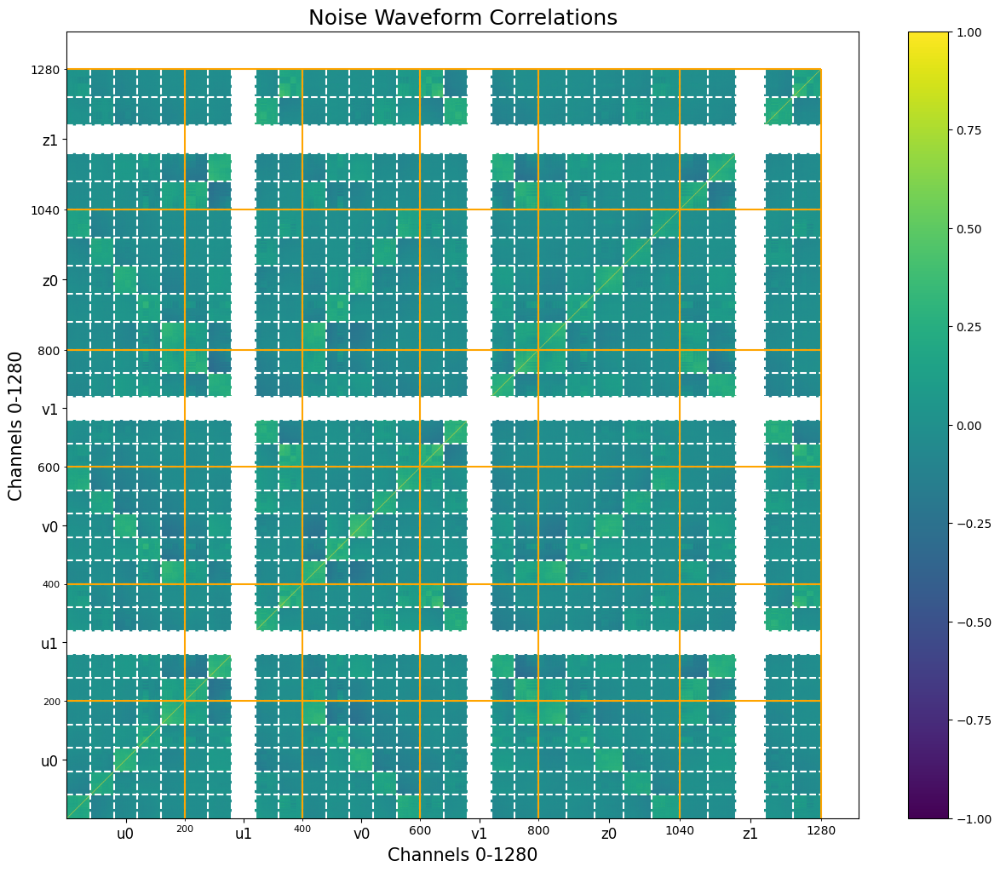

In [8]:
from plotter import plotter
plotter.plotrCorr(CorrMatrixOneEvent,BothLive)
plotter.plotrCorr(CorrMatrix,BothLive)

In [9]:
print(CorrMatrix == CorrMatrixOneEvent)

[[ True False False ... False False False]
 [False  True False ... False False False]
 [False False  True ... False False False]
 ...
 [False False False ...  True False False]
 [False False False ... False  True False]
 [False False False ... False False  True]]


In [7]:
import numpy as np
import matplotlib.pyplot as plt

def plot_waveform(waveform, sample_spacing, title="Waveform Plot", xlabel="Time [µs]", ylabel="Amplitude [ADC Counts]", output_file="waveform_plot.png", plotlabel="Waveform",ylim=(-15,15)):
    # Create time axis based on sample spacing
    time_axis = np.arange(len(waveform)) * sample_spacing * 1e6  # Convert to microseconds

    # Set up the figure
    plt.figure(figsize=(10, 6))

    # Plot waveform with enhanced aesthetics
    plt.plot(time_axis, waveform, color='darkblue', linewidth=2, label=plotlabel)

    # Labels and title
    plt.title(title, fontsize=22)
    plt.xlabel(xlabel, fontsize=18)
    plt.ylabel(ylabel, fontsize=18)

    # Grid and legend
    plt.grid(visible=True, linestyle='--', linewidth=0.5)
    plt.legend(fontsize=14)

    # Adjust tick labels
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylim(ylim)

    # Tight layout for better spacing
    plt.tight_layout()

    # Save the plot
    plt.savefig(output_file, dpi=300)
    print(f"Plot saved as {output_file}")

    # Display the plot
    plt.show()


2128
Plot saved as waveform_plot.png


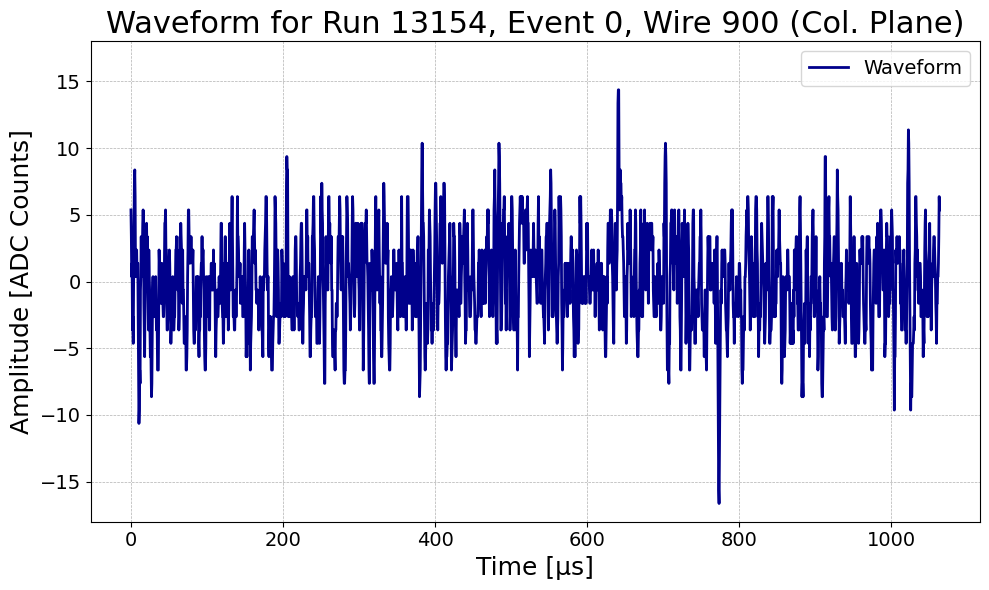

Plot saved as fft_plot.png


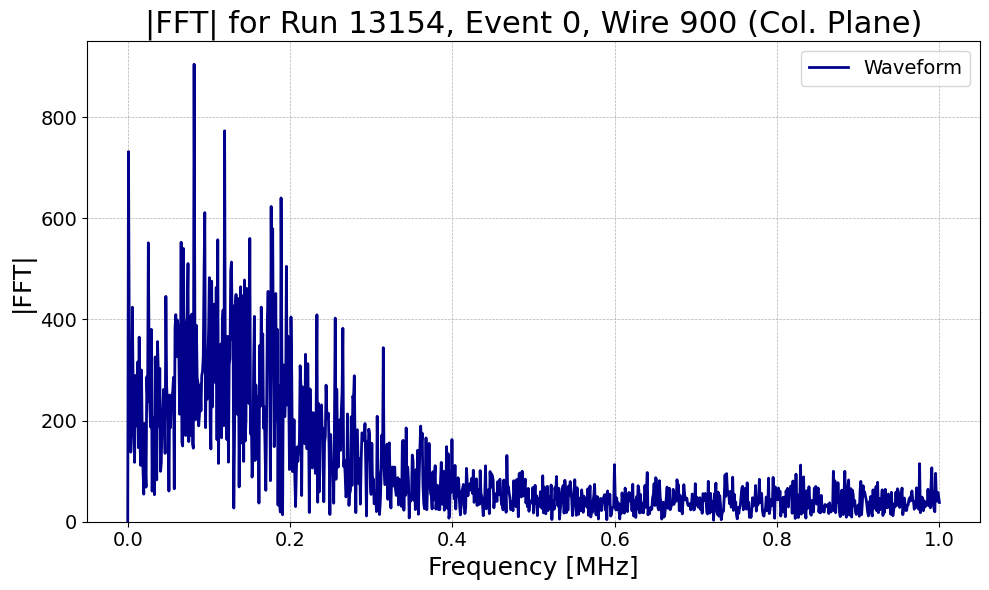

In [ ]:
#Plot one waveform from coll plane as an example:
noise_data = Noise[:, 800:1040, :]
import matplotlib.pyplot as plt

sample_spacing = 0.5e-6
waveform_to_plot = noise_data[0][100] - noise_data[0][100].mean(axis=0, keepdims=True)
print(len(waveform_to_plot))
plot_waveform(waveform_to_plot,sample_spacing,title="Waveform for Run 13154, Event 0, Wire 900 (Col. Plane)", ylim=(-18,18))

fft_of_waveform = np.abs(np.fft.rfft(waveform_to_plot))
freq = np.fft.rfftfreq(len(waveform_to_plot),d=sample_spacing)

plot_waveform(fft_of_waveform,(freq[1]-freq[0])/1e12,title="|FFT| for Run 13154, Event 0, Wire 900 (Col. Plane)",xlabel="Frequency [MHz]", ylabel="|FFT|", output_file="fft_plot.png", ylim=(0,950),plotlabel="|FFT|")

In [14]:
## Same plots for a simulated event to show clear visual comparison:
sim_infile = uproot.open("/exp/dune/data/users/mking/ICEBERG_Noise_Ar_39/iceberg_noise/AR_39_sim/01_24_2025/Waveforms_Sim.root")


In [15]:
keys_sim = sim_infile.keys()
Noise_sim = np.zeros((50,1280,2128),dtype=np.float32)
CorrMatrix_sim = np.zeros((1280,1280),dtype=np.float32)
CorrMatrixOneEvent_sim = np.zeros((1280,1280),dtype=np.float32)
LiveWire_sim = np.zeros(1280)
BothLive_sim = np.zeros((1280,1280),dtype=np.float32)

for iEvent in range(50):
    key = keys_sim[iEvent*2] #daq only

    H, xedges, yedges = sim_infile[key].to_numpy()
    Noise_sim[iEvent] = H
    CorrMatrix_sim+=np.corrcoef(H)

    if iEvent==0:
        CorrMatrixOneEvent_sim+=np.corrcoef(H)
        LiveWire_sim = np.any(H != 0, axis=1).astype(int)
    count+=1

BothLive_sim = np.outer(LiveWire_sim, LiveWire_sim)
CorrMatrix_sim /= 50


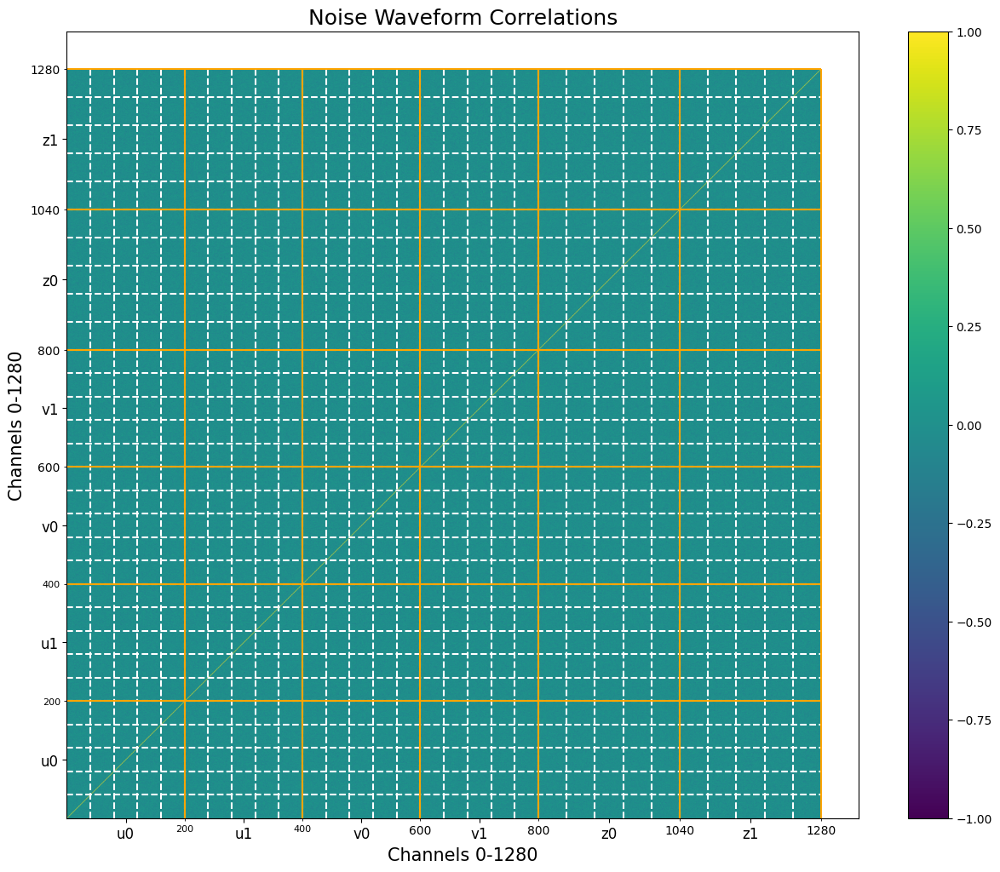

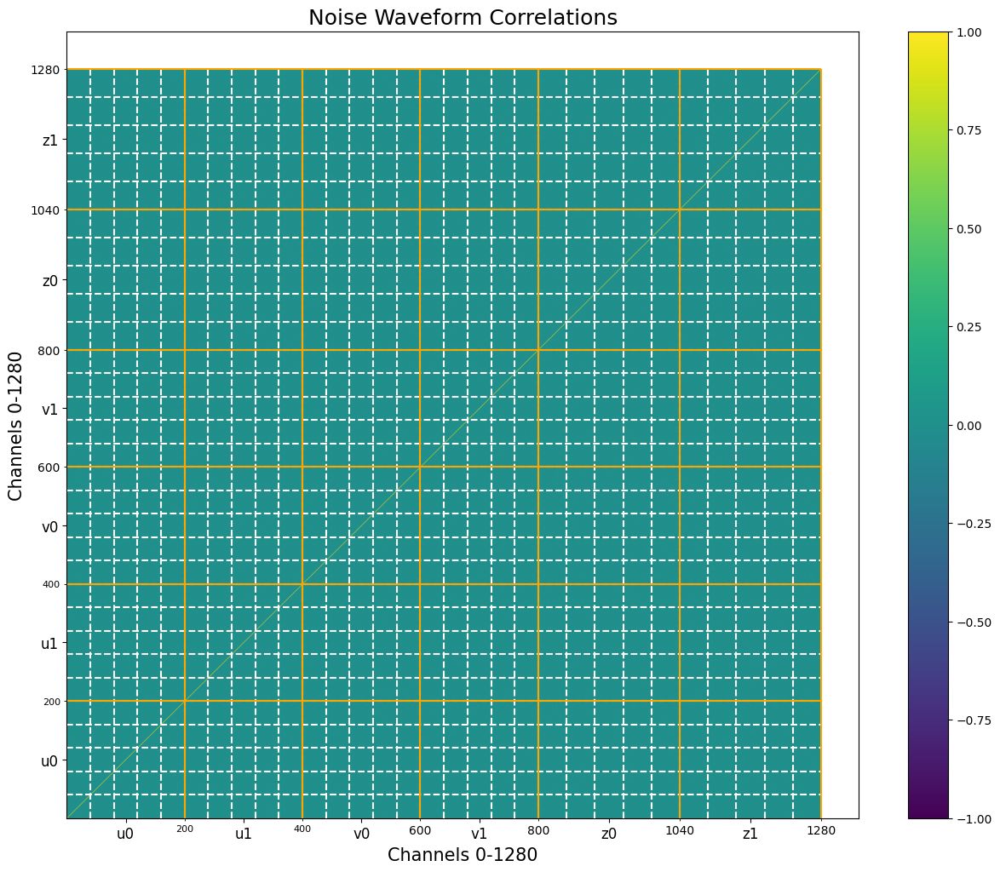

In [20]:
from plotter import plotter
plotter.plotrCorr(CorrMatrixOneEvent_sim,BothLive_sim,outputFile = 'rCorr_sim.png')
plotter.plotrCorr(CorrMatrix_sim,BothLive_sim,outputFile = 'rCorr_sim.png')

2128
Plot saved as waveform_plot_sim.png


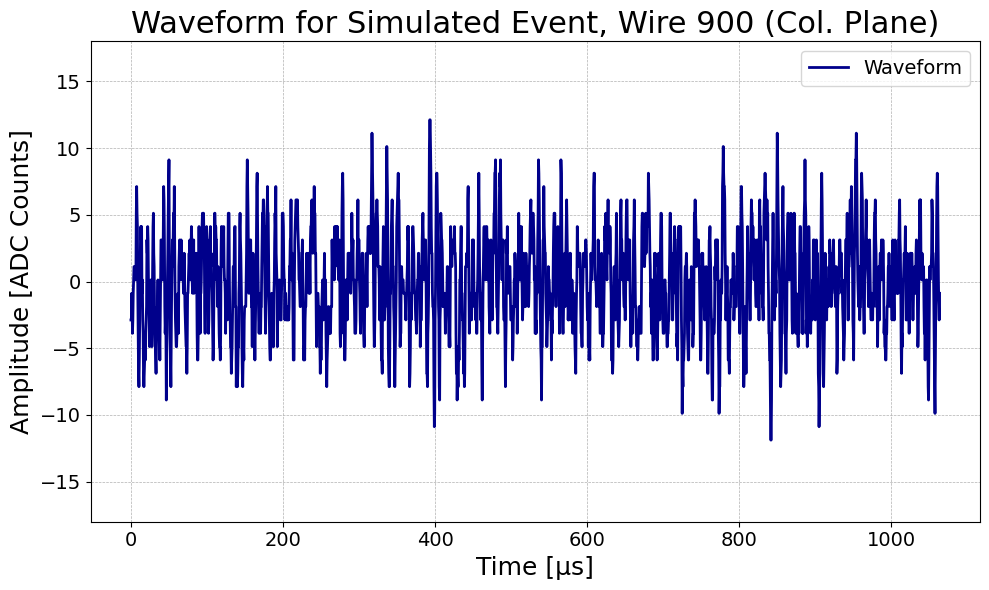

Plot saved as fft_plot_sim.png


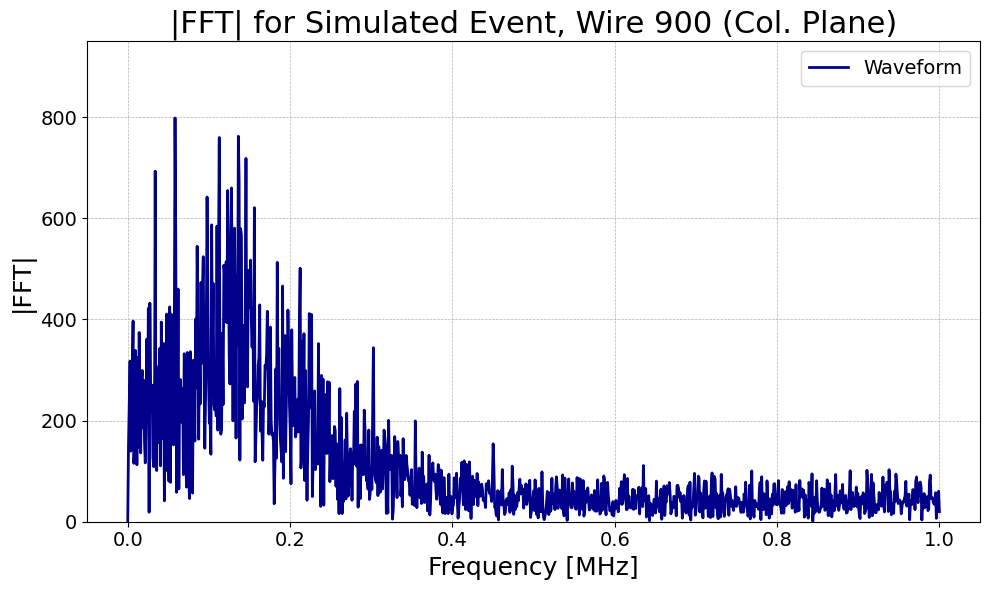

Plot saved as fft_plot_sim.png


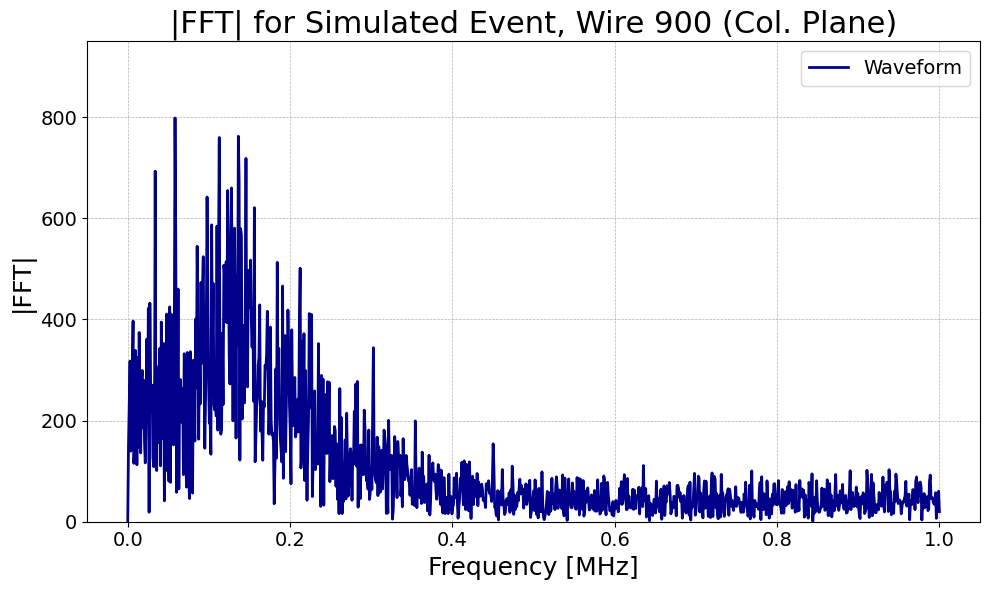

In [ ]:
#Plot one waveform from coll plane as an example:
noise_sim = Noise_sim[:, 800:1040, :]
import matplotlib.pyplot as plt

sample_spacing = 0.5e-6
waveform_to_plot = noise_sim[0][100] - noise_sim[0][100].mean(axis=0, keepdims=True)
print(len(waveform_to_plot))
plot_waveform(waveform_to_plot,sample_spacing,title="Waveform for Simulated Event, Wire 900 (Col. Plane)",output_file="waveform_plot_sim.png",ylim=(-18,18))

fft_of_waveform = np.abs(np.fft.rfft(waveform_to_plot))
freq = np.fft.rfftfreq(len(waveform_to_plot),d=sample_spacing)

plot_waveform(fft_of_waveform,(freq[1]-freq[0])/1e12,title="|FFT| for Simulated Event, Wire 900 (Col. Plane)",xlabel="Frequency [MHz]", ylabel="|FFT|", output_file="fft_plot_sim.png", ylim=(0,950),plotlabel="|FFT|")

Plot saved as avg_fft_plot.png


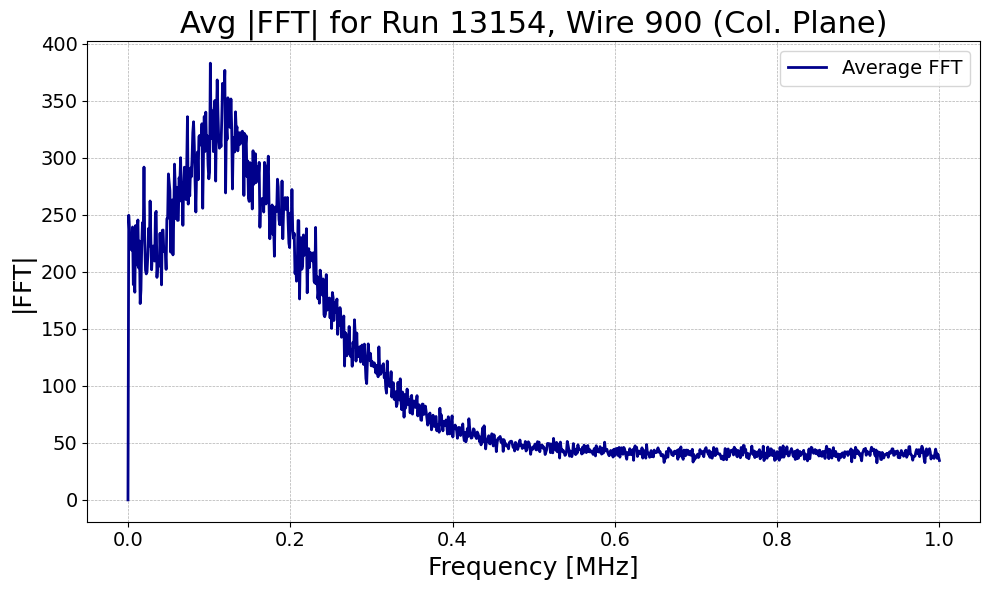

In [6]:
Noise_Model = np.load("AverageFFT_No_Cosmics.npz")
AvgFFT = Noise_Model['FFT']
sample_spacing=0.5e-6
freq = np.fft.rfftfreq(2128,d=sample_spacing)
plot_waveform(AvgFFT[900],(freq[1]-freq[0])/1e12,title="Avg |FFT| for Run 13154, Wire 900 (Col. Plane)",xlabel="Frequency [MHz]", ylabel="|FFT|", output_file="avg_fft_plot.png", plotlabel = "Average FFT")

619.4568
4162
24510398


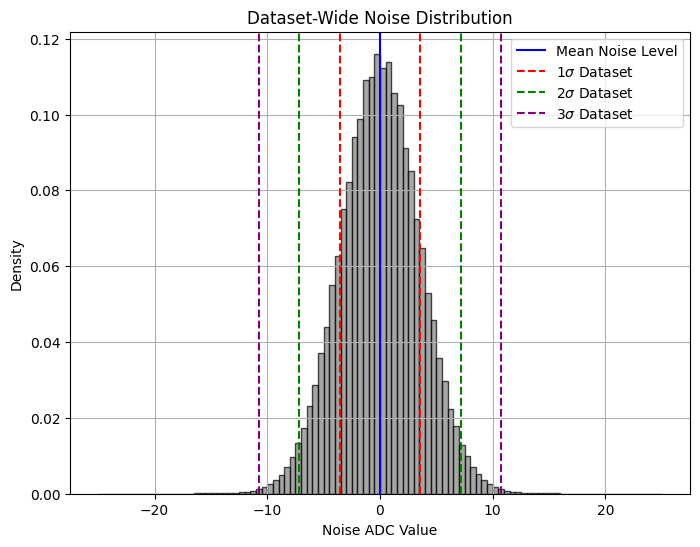

In [22]:
#Also make histograms of noise across data
import numpy as np
import matplotlib.pyplot as plt

# Extract TPC 0 Plane Z (channels 800-1039)
noise_data = Noise[:, 800:1040, :]
noise_data -= noise_data.mean(axis=2, keepdims=True)

# Compute dataset-wide noise statistics
noise_values = noise_data.flatten()
noise_mean = np.mean(noise_values)
noise_std = np.std(noise_values)

#manually kill outlier:
print(np.max(noise_values))
print(len(noise_values[np.abs(noise_values)>=25]))
print(len(noise_values[np.abs(noise_values)<25]))
noise_values = noise_values[np.abs(noise_values)<25]

# Dataset-wide noise distribution histogram
fig = plt.figure(figsize=(8, 6))
plt.hist(noise_values, bins=100, alpha=0.7, color='gray', edgecolor='black', density=True)
plt.axvline(noise_mean, color='blue', linestyle='solid', label="Mean Noise Level")
plt.axvline(noise_mean + noise_std, color='r', linestyle='dashed', label=r'$1\sigma$ Dataset')
plt.axvline(noise_mean - noise_std, color='r', linestyle='dashed')
plt.axvline(noise_mean + 2 * noise_std, color='g', linestyle='dashed', label=r'$2\sigma$ Dataset')
plt.axvline(noise_mean - 2 * noise_std, color='g', linestyle='dashed')
plt.axvline(noise_mean + 3 * noise_std, color='purple', linestyle='dashed', label=r'$3\sigma$ Dataset')
plt.axvline(noise_mean - 3 * noise_std, color='purple', linestyle='dashed')
plt.xlabel("Noise ADC Value")
plt.ylabel("Density")
plt.title(f"Dataset-Wide Noise Distribution")
plt.legend()
plt.grid(True)
fig.savefig("NoiseHisto.svg", dpi = fig.dpi)
plt.show()